In [2]:
from pymongo import MongoClient
import time

client = MongoClient("mongodb://localhost:27017/")
db = client['Project']

In [6]:
import pandas as pd

# Load the CSV file into a DataFrame
df = pd.read_csv("Covid19.csv")
df['date'] = pd.to_datetime(df['date'])

client = MongoClient("mongodb://localhost:27017/")
db = client["Project"]
collection = db["CovidData"]


In [7]:
print(df.info())

# Fix column names (strip spaces just in case)
df.columns = [col.strip() for col in df.columns]

# Convert date column to datetime
df['date'] = pd.to_datetime(df['date'], errors='coerce')

# Make sure numerical columns are numbers
numerical_columns = [
    'cumulative_total_cases', 'daily_new_cases',
    'active_cases', 'cumulative_total_deaths', 'daily_new_deaths'
]

for col in numerical_columns:
    df[col] = pd.to_numeric(df[col], errors='coerce')

# Drop rows with missing critical data
df.dropna(subset=['date', 'country'], inplace=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 184787 entries, 0 to 184786
Data columns (total 7 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   date                     184787 non-null  datetime64[ns]
 1   country                  184787 non-null  object        
 2   cumulative_total_cases   184787 non-null  float64       
 3   daily_new_cases          174329 non-null  float64       
 4   active_cases             166747 non-null  float64       
 5   cumulative_total_deaths  178227 non-null  float64       
 6   daily_new_deaths         157850 non-null  float64       
dtypes: datetime64[ns](1), float64(5), object(1)
memory usage: 9.9+ MB
None


In [8]:
df['stats'] = df.apply(lambda row: {
    "cumulative_total_cases": row["cumulative_total_cases"],
    "daily_new_cases": row["daily_new_cases"],
    "active_cases": row["active_cases"],
    "cumulative_total_deaths": row["cumulative_total_deaths"],
    "daily_new_deaths": row["daily_new_deaths"]
}, axis=1)

# Keep only essential columns for insertion
mongo_df = df[['date', 'country', 'stats']]

In [10]:
from pymongo import MongoClient

# Connect to MongoDB
client = MongoClient("mongodb://localhost:27017/")
db = client["Project"]
collection = db["CovidData"]

# Convert to records
data_to_insert = mongo_df.to_dict("records")

# Insert the data
collection.insert_many(data_to_insert)

# Create indexes for query performance
collection.create_index([("date", 1)])
collection.create_index([("country", 1)])
collection.create_index([("date", 1), ("country", 1)])


'date_1_country_1'

In [23]:
# All data for Finland
collection.find({"country": "Finland"})

# Data for Finland on a specific date
from datetime import datetime
collection.find({"country": "Finland", "date": datetime(2020, 3, 15)})

for doc in collection.find({"daily_new_cases": {"$gt": 100}}):
    print(doc)


{'_id': ObjectId('67f61bbdb91b9f106d12e477'), 'date': datetime.datetime(2020, 4, 23, 0, 0), 'country': 'Afghanistan', 'cumulative_total_cases': 1279.0, 'daily_new_cases': 103.0, 'active_cases': 1058.0, 'cumulative_total_deaths': 42.0, 'daily_new_deaths': 2.0}
{'_id': ObjectId('67f61bbdb91b9f106d12e479'), 'date': datetime.datetime(2020, 4, 25, 0, 0), 'country': 'Afghanistan', 'cumulative_total_cases': 1463.0, 'daily_new_cases': 112.0, 'active_cases': 1228.0, 'cumulative_total_deaths': 47.0, 'daily_new_deaths': 4.0}
{'_id': ObjectId('67f61bbdb91b9f106d12e47b'), 'date': datetime.datetime(2020, 4, 27, 0, 0), 'country': 'Afghanistan', 'cumulative_total_cases': 1703.0, 'daily_new_cases': 172.0, 'active_cases': 1426.0, 'cumulative_total_deaths': 57.0, 'daily_new_deaths': 7.0}
{'_id': ObjectId('67f61bbdb91b9f106d12e47c'), 'date': datetime.datetime(2020, 4, 28, 0, 0), 'country': 'Afghanistan', 'cumulative_total_cases': 1828.0, 'daily_new_cases': 125.0, 'active_cases': 1542.0, 'cumulative_total_

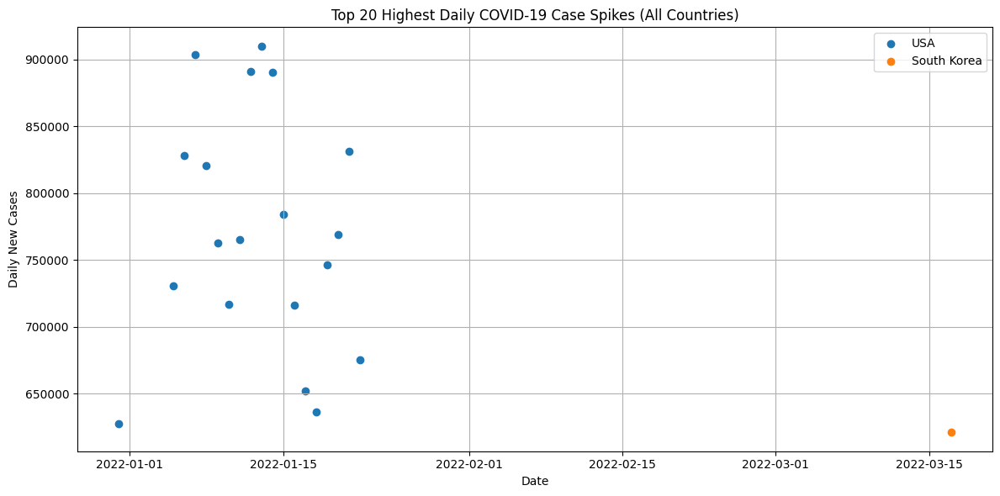

In [27]:
import pandas as pd
import matplotlib.pyplot as plt
from pymongo import MongoClient

# Query all needed fields
cursor = collection.find({}, {
    "country": 1,
    "date": 1,
    "stats.daily_new_cases": 1,
    "_id": 0
})

# Convert to DataFrame
data = list(cursor)
df = pd.DataFrame(data)

# Flatten the nested stats field
df['daily_new_cases'] = df['stats'].apply(lambda x: x['daily_new_cases'] if isinstance(x, dict) and 'daily_new_cases' in x else None)
df.drop(columns=['stats'], inplace=True)

# Drop missing or bad data
df.dropna(subset=['daily_new_cases', 'date', 'country'], inplace=True)

# Convert date to datetime just in case
df['date'] = pd.to_datetime(df['date'])

# Optional: sort by spikes
top_spikes = df.nlargest(20, 'daily_new_cases')

# Plotting the top spikes
plt.figure(figsize=(12, 6))
for country in top_spikes['country'].unique():
    country_df = top_spikes[top_spikes['country'] == country]
    # Change plt.plot to plt.scatter to remove lines and just plot markers
    plt.scatter(country_df['date'], country_df['daily_new_cases'], marker='o', label=country)

plt.title("Top 20 Highest Daily COVID-19 Case Spikes (All Countries)")
plt.xlabel("Date")
plt.ylabel("Daily New Cases")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


C:\Users\rawil\AppData\Local\Temp\ipykernel_17208\4279145011.py:34: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab20', len(top_spikes['country'].unique()))  # Get a color palette


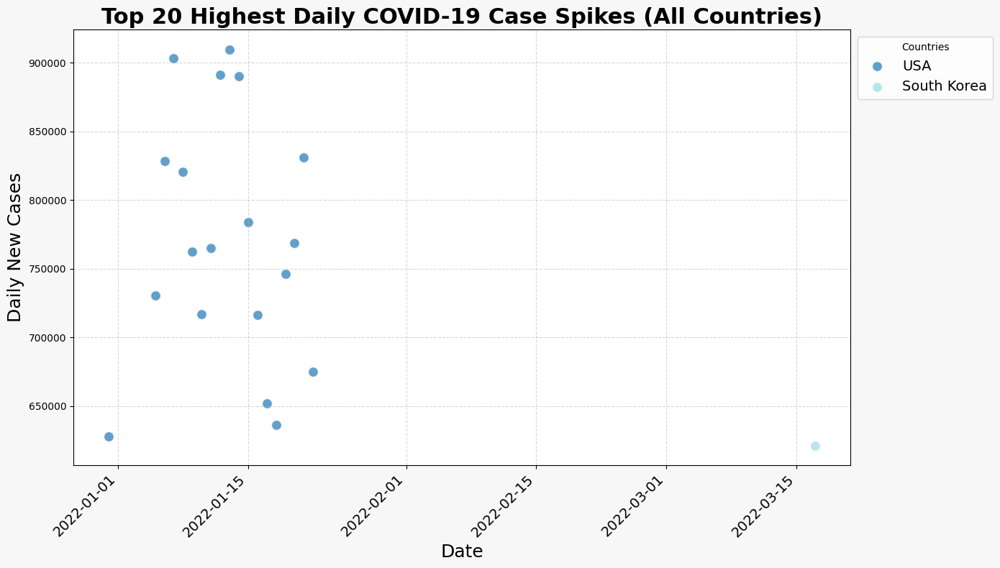

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
from pymongo import MongoClient

# Query all needed fields
cursor = collection.find({}, {
    "country": 1,
    "date": 1,
    "stats.daily_new_cases": 1,
    "_id": 0
})

# Convert to DataFrame
data = list(cursor)
df = pd.DataFrame(data)

# Flatten the nested stats field
df['daily_new_cases'] = df['stats'].apply(lambda x: x['daily_new_cases'] if isinstance(x, dict) and 'daily_new_cases' in x else None)
df.drop(columns=['stats'], inplace=True)

# Drop missing or bad data
df.dropna(subset=['daily_new_cases', 'date', 'country'], inplace=True)

# Convert date to datetime just in case
df['date'] = pd.to_datetime(df['date'])

# Optional: sort by spikes
top_spikes = df.nlargest(20, 'daily_new_cases')

# Plotting the top spikes
plt.figure(figsize=(14, 8), facecolor='#f7f7f7')

# Use a color palette for countries
colors = plt.cm.get_cmap('tab20', len(top_spikes['country'].unique()))  # Get a color palette

for i, country in enumerate(top_spikes['country'].unique()):
    country_df = top_spikes[top_spikes['country'] == country]
    # Use scatter with custom color, size, and alpha for transparency
    plt.scatter(country_df['date'], country_df['daily_new_cases'], 
                color=colors(i), marker='o', label=country, s=100, alpha=0.7, edgecolors='w')

# Enhance labels, titles, and axes
plt.title("Top 20 Highest Daily COVID-19 Case Spikes (All Countries)", fontsize=22, weight='bold')
plt.xlabel("Date", fontsize=18)
plt.ylabel("Daily New Cases", fontsize=18)

# Rotate date labels for readability
plt.xticks(rotation=45, ha='right', fontsize=14)

# Add grid lines but make them subtle
plt.grid(True, linestyle='--', alpha=0.5)

# Add legend and adjust its position
plt.legend(title='Countries', fontsize=14, loc='upper left', bbox_to_anchor=(1, 1), fancybox=True)

# Adjust layout to prevent overlap and improve tightness
plt.tight_layout()

# Show the plot
plt.show()
